<a href="https://colab.research.google.com/github/MFaisalJaffer/HumanDetection/blob/main/Final%20Project%20Section%20AAI-510-Team%204.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Voice Gender Classification: Leveraging Machine Learning for Accurate Gender Prediction

Rene Ortiz  
Matt Purkeypile  
Stephanie M. Tabares  
June 2024  
AAI 510: Final Project


## Introduction
This project aims to classify the gender of individuals based on acoustic features extracted from voice recordings. By leveraging various machine learning techniques, we strive to develop a robust model that can accurately predict gender from voice data. This project will follow a structured approach to ensure a comprehensive analysis and effective model development.

## Problem Statement
The objective of this project is to create a machine learning model that can accurately predict whether a given voice recording is of a male or female. This model can have applications in voice assistants, automated customer service systems, and gender-based analytics in voice data.

## Dataset Description
The dataset used in this project is the "Voice Gender" dataset, which contains acoustic properties of voice recordings and is used for gender classification. The dataset includes 20 features and 1 target variable (`label`), where `label` indicates the gender of the speaker (male or female).


# Data Loading and Initial Exploration
In the following cells, we import the necessary libraries and import the data.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder

In [2]:
# Load the dataset
#data set taken from: https://www.kaggle.com/code/gmishrakec/gender-recognition-by-voice-and-speech-analysis/data
data = pd.read_csv("./voice.csv")

# Display the first few rows of the dataset to get an overview
print("First few rows of the dataset:")
print(data.head())

# Get the number of variables (columns)
num_variables = data.shape[1]
print(f'Number of variables: {num_variables}')

# Get the size of the dataset (number of rows)
dataset_size = data.shape[0]
print(f'Size of the dataset: {dataset_size} rows')

# Check the distribution of the target variable 'label'
label_counts = data['label'].value_counts()
print("Distribution of labels:")
print(label_counts)

FileNotFoundError: [Errno 2] No such file or directory: './voice.csv'

### Manual Encoding and Verification
Here we translate the target variable ("label") to an interger value and verify the translation is correct.

In [ ]:
# Manually encode the target variable
data['label'] = data['label'].map({'male': 1, 'female': 0})

# Verify the encoding
print("After encoding, distribution of labels:")
print(data['label'].value_counts())

# Map the encoded labels back to their original string representations for visualization
data['label'] = data['label'].map({1: 'male', 0: 'female'})

# Verify the reverse encoding
print("After reverse encoding, distribution of labels:")
print(data['label'].value_counts())

After encoding, distribution of labels:
1    1584
0    1584
Name: label, dtype: int64
After reverse encoding, distribution of labels:
male      1584
female    1584
Name: label, dtype: int64


# EDA

Rene's EDA using Dataprep (COLAB)

In [3]:

!pip install dataprep > /dev/null 2>&1


In [4]:
import seaborn as sns
import matplotlib.pyplot as plt #to allow subplot creation
import pandas as pd
import warnings

# Apply the seaborn theme
sns.set_theme() #overwrite default Matplotlib styling parameters
import numpy as np

from dataprep.eda import *
from dataprep.datasets import load_dataset
from dataprep.eda import plot, plot_correlation, plot_missing, plot_diff, create_report #


In [5]:
# Using Colab to use DATAPREP - load dataset from Google Drive using pandas
# already loaded as "data" above if you want to reuse that Rene
from google.colab import drive
drive.mount('/content/drive')

# Load CSV file
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/voice.csv')
# Manually encode the target variable
df['label'] = df['label'].map({'male': 1, 'female': 0})
df.head()

Mounted at /content/drive


,meanfreq,sd,median,Q25,Q75,IQR,skew,kurt,sp.ent,sfm,...,centroid,meanfun,minfun,maxfun,meandom,mindom,maxdom,dfrange,modindx,label
0,0.059781,0.064241,0.032027,0.015071,0.090193,0.075122,12.863462,274.402906,0.893369,0.491918,...,0.059781,0.084279,0.015702,0.275862,0.007812,0.007812,0.007812,0.000000,0.000000,1
1,0.066009,0.067310,0.040229,0.019414,0.092666,0.073252,22.423285,634.613855,0.892193,0.513724,...,0.066009,0.107937,0.015826,0.250000,0.009014,0.007812,0.054688,0.046875,0.052632,1
2,0.077316,0.083829,0.036718,0.008701,0.131908,0.123207,30.757155,1024.927705,0.846389,0.478905,...,0.077316,0.098706,0.015656,0.271186,0.007990,0.007812,0.015625,0.007812,0.046512,1
3,0.151228,0.072111,0.158011,0.096582,0.207955,0.111374,1.232831,4.177296,0.963322,0.727232,...,0.151228,0.088965,0.017798,0.250000,0.201497,0.007812,0.562500,0.554688,0.247119,1
4,0.135120,0.079146,0.124656,0.078720,0.206045,0.127325,1.101174,4.333713,0.971955,0.783568,...,0.135120,0.106398,0.016931,0.266667,0.712812,0.007812,5.484375,5.476562,0.208274,1


In [6]:
# Features plotting using dataprep
# Features Plotting
plot(df)

/usr/local/lib/python3.10/dist-packages/dask/dataframe/core.py:3725: UserWarning: Dask currently has limited support for converting pandas extension dtypes to arrays. Converting int64[pyarrow] to object dtype.
  warnings.warn(


KeyError: 'label'

Computing isnull-b4b286a6f3a9c4c447388503f765cbe2:   0%|          | 0/230 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/dask/core.py:121: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))



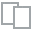
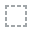
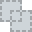
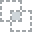
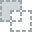
...
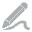
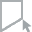
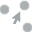
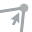
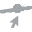

In [7]:
# Plot missing values from the dataset
plot_missing(df)


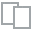
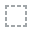
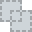
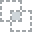
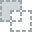
...
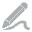
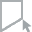
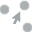
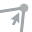
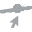

In [8]:
plot_correlation(df)

In [9]:
# Plot the correlation of each feature with gender
plot(df, 'meanfreq','label')

/usr/local/lib/python3.10/dist-packages/dask/dataframe/core.py:7084: FutureWarning: Meta is not valid, `map_partitions` and `map_overlap` expects output to be a pandas object. Try passing a pandas object as meta or a dict or tuple representing the (name, dtype) of the columns. In the future the meta you passed will not work.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/dask/dataframe/core.py:7084: FutureWarning: Meta is not valid, `map_partitions` and `map_overlap` expects output to be a pandas object. Try passing a pandas object as meta or a dict or tuple representing the (name, dtype) of the columns. In the future the meta you passed will not work.
  warnings.warn(


TypeError: ufunc 'isinf' not supported for the input types, and the inputs could not be safely coerced to any supported types according to the casting rule ''safe''

### Non-Graphical Representation

In [ ]:
# Display statistical summary of the dataset
print("Statistical Summary:")
print(data.describe())

# Display correlation matrix
print("\nCorrelation Matrix:")
corr_matrix = data.corr(numeric_only=True)
print(corr_matrix)

Statistical Summary:
          meanfreq           sd       median          Q25          Q75  \
count  3168.000000  3168.000000  3168.000000  3168.000000  3168.000000   
mean      0.180907     0.057126     0.185621     0.140456     0.224765   
std       0.029918     0.016652     0.036360     0.048680     0.023639   
min       0.039363     0.018363     0.010975     0.000229     0.042946   
25%       0.163662     0.041954     0.169593     0.111087     0.208747   
50%       0.184838     0.059155     0.190032     0.140286     0.225684   
75%       0.199146     0.067020     0.210618     0.175939     0.243660   
max       0.251124     0.115273     0.261224     0.247347     0.273469   

               IQR         skew         kurt       sp.ent          sfm  \
count  3168.000000  3168.000000  3168.000000  3168.000000  3168.000000   
mean      0.084309     3.140168    36.568461     0.895127     0.408216   
std       0.042783     4.240529   134.928661     0.044980     0.177521   
min       0.0145

### Graphical Representation

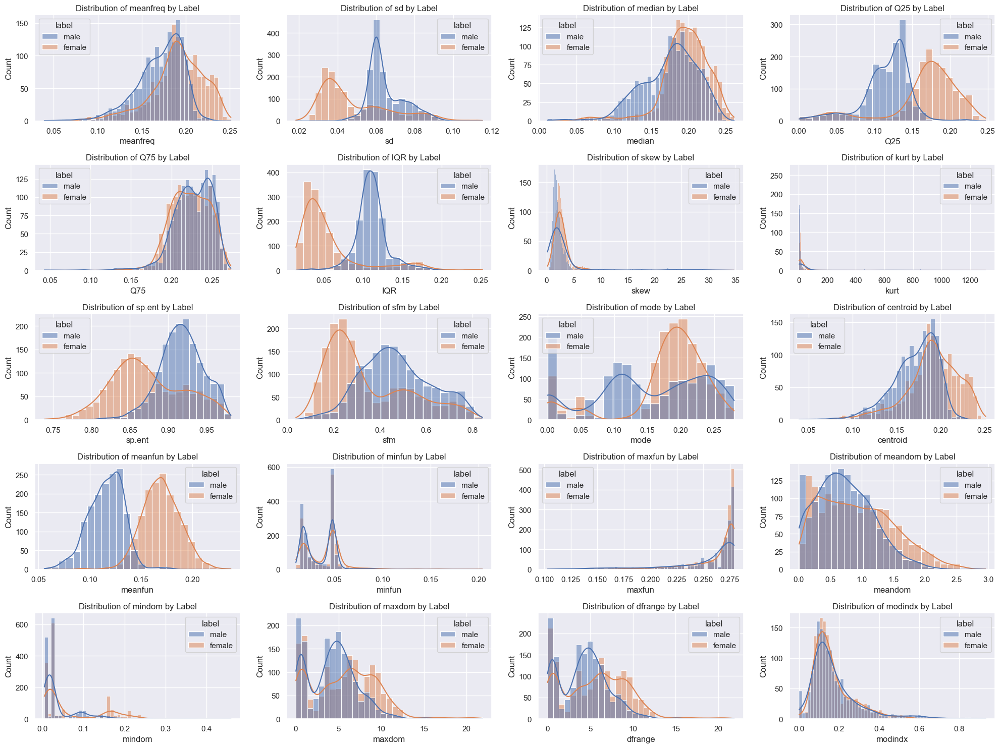

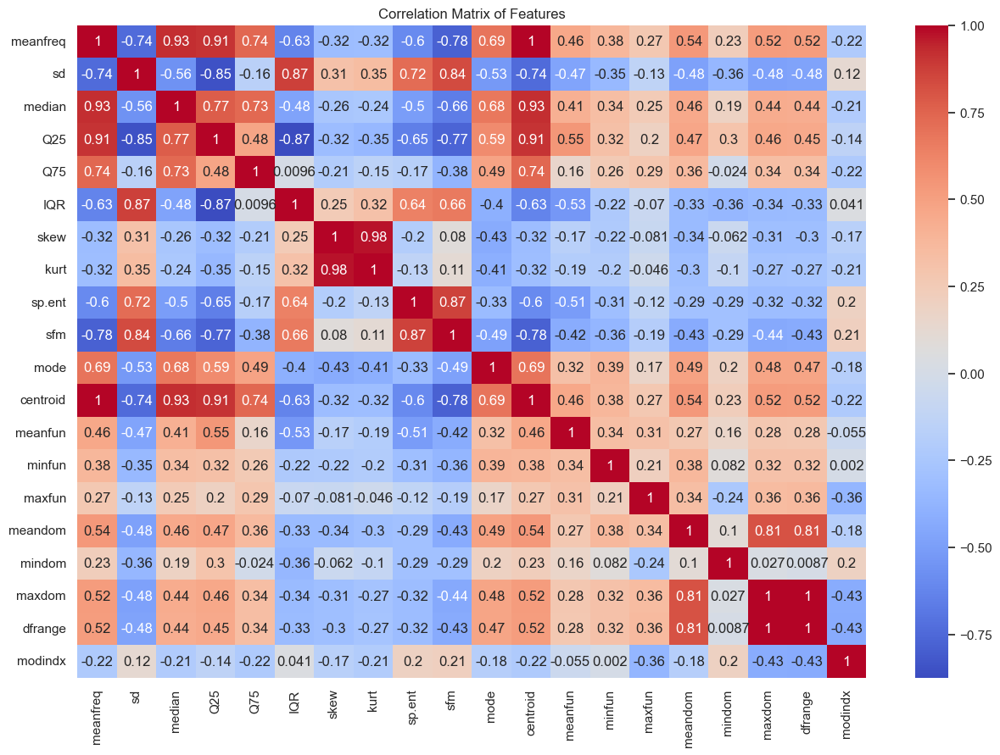

In [ ]:
# Plot the distribution of each feature grouped by label
plt.figure(figsize=(20, 15))
for i, column in enumerate(data.columns[:-1], 1):
    plt.subplot(5, 4, i)
    sns.histplot(data=data, x=column, hue='label', kde=True)
    plt.title(f'Distribution of {column} by Label')
plt.tight_layout()
plt.show()

# Plot heatmap of correlation matrix
plt.figure(figsize=(15, 10))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix of Features')
plt.show()

It is interesting to note that several of the features are similar between the two labels of male and female. For example, the meanfreq is pretty similar between the sexes. That's probably not to surprising, since humans speak in a somewhat narrow frequency band. However, other characteristics such as meanfun show a clear difference between the sexes.

# Feauture Engineering
Some feature engineering was done above, when we mapped the sexes to integer values. There are no missing values in the data set.

In [ ]:
# Check for missing values
missing_values = data.isnull().sum()
print("Missing values in the dataset:")
print(missing_values)

Missing values in the dataset:
meanfreq    0
sd          0
median      0
Q25         0
Q75         0
IQR         0
skew        0
kurt        0
sp.ent      0
sfm         0
mode        0
centroid    0
meanfun     0
minfun      0
maxfun      0
meandom     0
mindom      0
maxdom      0
dfrange     0
modindx     0
label       0
dtype: int64


# Feature Selection
There isn't an overwhelming number of features here. So we'll use all or most of them with our models.

### Top 5 Features through Correlation Analysis

In [ ]:
# Correlation analysis for a quick overview
# Convert 'label' to numeric
data['label'] = data['label'].map({'male': 1, 'female': 0})

# Calculate correlation matrix
correlation_matrix = data.corr()

# Get the correlation values with the target variable 'label'
correlation_with_label = correlation_matrix['label'].sort_values(ascending=False)

# Print the top 5 features with the highest correlation with 'label'
print("Top 5 features correlated with 'label':")
print(correlation_with_label[1:6])

Top 5 features correlated with 'label':
IQR       0.618916
sp.ent    0.490552
sd        0.479539
sfm       0.357499
kurt      0.087195
Name: label, dtype: float64


This is inline with the graphs above, so not unexpected. For example, IQR has a normal distribution for each sex. These two distributions are clearly offset from one and other. The peak for males is approximately 3x the value of the peak for females.

### Pair Plot

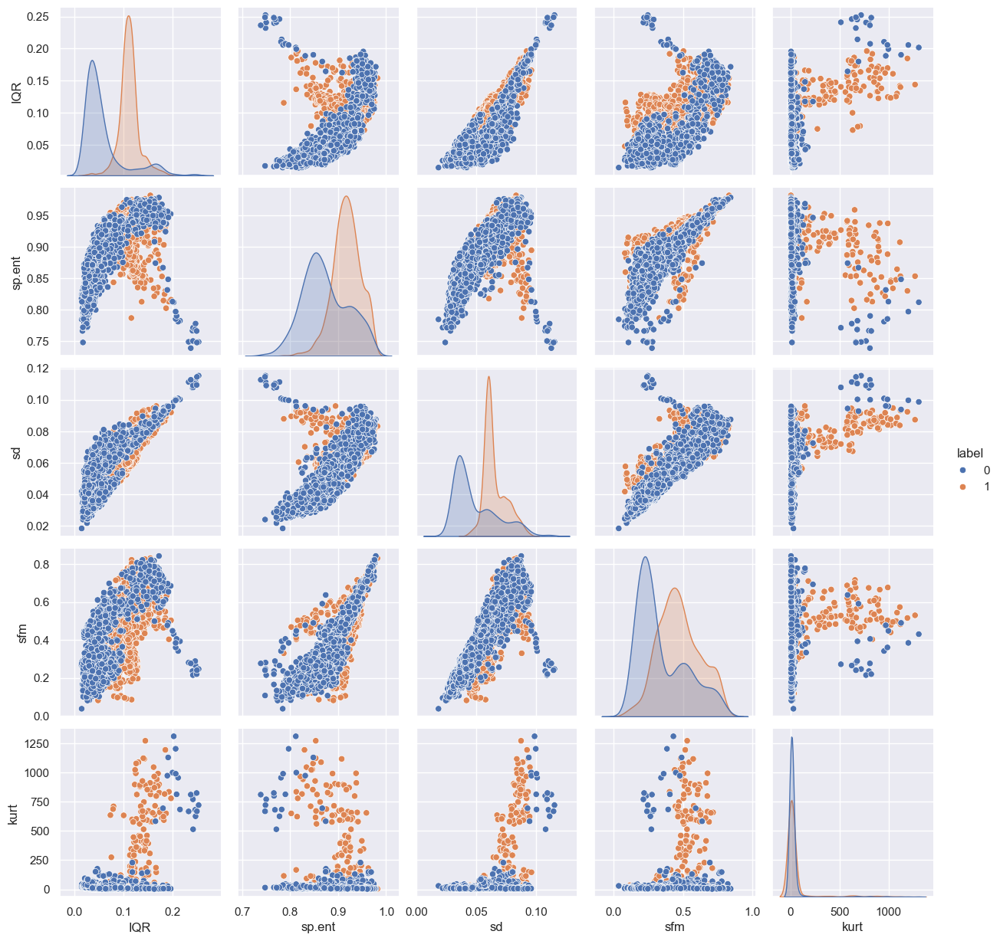

In [ ]:
# Pair plot
sns.pairplot(data, vars=['IQR', 'sp.ent', 'sd', 'sfm', 'kurt'], hue='label', diag_kind='kde')

# Show the plot
plt.show()

From the above, we can again see that IQR is very different betwen the sexes.

# Data Preperation
To further prepare the data, we'll first shuffle the data. The shuffling is done with a specific seed in order to make results repeatable from run to run, per the [Pandas documentation on sample()](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.sample.html). Without this seed typically something like the system clock is used, which leads to different results from run to run.

The data is also split into train (60%), validation (20%), and test (20%) sets. These are then used to train, validate, and test the models later on.

In [ ]:
# split the data into train, validate and test sets
# shuffle first since they're ordered by male/female. Set the random number
# generator seed so that the results are consistent from run to run
AllData = data.sample(frac = 1, random_state = 1234)
AllData['label'] = AllData['label'].map({'male': 1, 'female': 0})   # map to ints

# according to Meta AI, common percentages are 60%, 20%, 20% for the three
NumRows = AllData.shape[0]
LastTrainIndex = int(0.6 * NumRows)
LastValidationIndex = int(0.8 * NumRows)
TrainData = AllData[ : LastTrainIndex]
ValidationData = AllData[(LastTrainIndex + 1) : LastValidationIndex]
TestData = AllData[(LastValidationIndex + 1) : ]
print(str(TrainData))

      meanfreq        sd    median       Q25       Q75       IQR      skew  \
2471  0.151091  0.066940  0.147940  0.099045  0.212299  0.113254  1.047134   
2777  0.193523  0.038389  0.200042  0.165188  0.218787  0.053598  1.752535   
630   0.141419  0.073749  0.140326  0.083413  0.208099  0.124686  1.500373   
819   0.184012  0.063713  0.193985  0.124165  0.244010  0.119846  1.545898   
2573  0.249637  0.033361  0.260541  0.239459  0.268649  0.029189  2.845611   
...        ...       ...       ...       ...       ...       ...       ...   
1536  0.162870  0.058276  0.145018  0.112736  0.218280  0.105544  2.634134   
1938  0.166078  0.091112  0.207214  0.074179  0.236816  0.162637  4.237644   
853   0.168699  0.062555  0.187945  0.105479  0.208082  0.102603  2.053356   
2671  0.201565  0.035545  0.195694  0.177348  0.230203  0.052855  2.250705   
577   0.130484  0.081463  0.116764  0.065411  0.207169  0.141757  1.345414   

           kurt    sp.ent       sfm  ...  centroid   meanfun   

# Modeling

### Single classification tree
The first model we use is a single classification tree.

Train accuracy =  1.0
Validation accuracy =  0.95260663507109


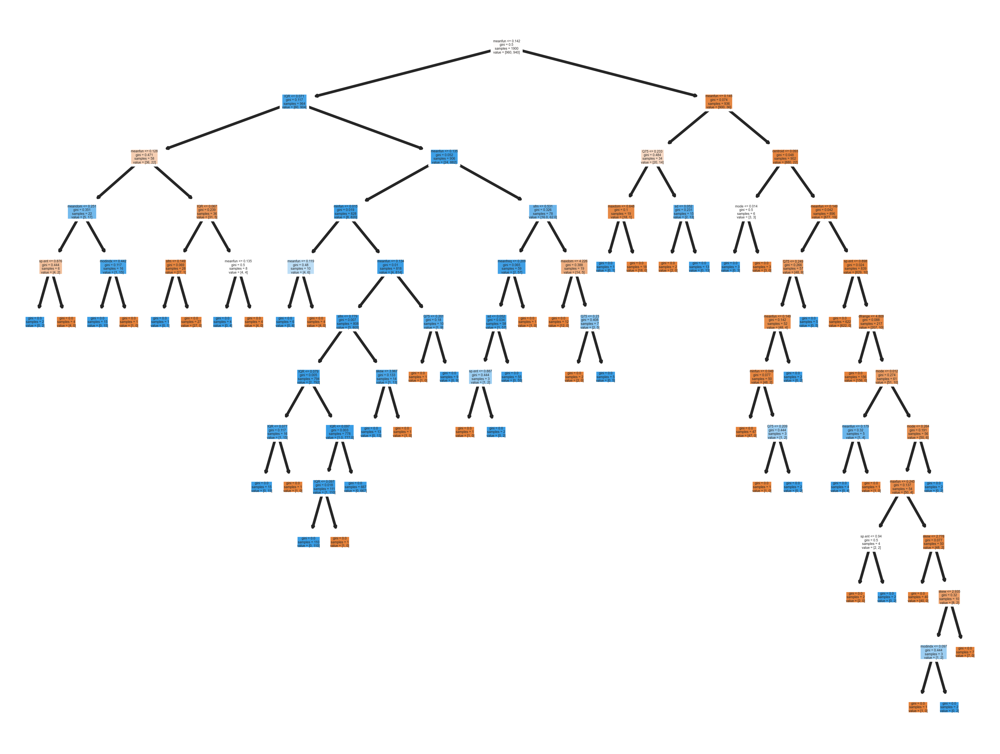

In [ ]:
from sklearn import tree
from sklearn import metrics

# train it
DecisionTree = tree.DecisionTreeClassifier(random_state = 1234)
DecisionTree = DecisionTree.fit(TrainData.drop(columns = ["label"]), TrainData["label"])

# test it
TrainPredicitions = DecisionTree.predict(TrainData.drop(columns = ["label"]))
ValidationPredictions = DecisionTree.predict(ValidationData.drop(columns = ["label"]))
print("Train accuracy = ", metrics.accuracy_score(TrainData["label"], TrainPredicitions))
print("Validation accuracy = ", metrics.accuracy_score(ValidationData["label"], ValidationPredictions))

# visualize it
plt.rcParams['figure.dpi'] = 600
FeatureNames = list(TrainData.drop(columns = ["label"]).columns)
tree.plot_tree(DecisionTree, filled = True, feature_names = FeatureNames)
plt.show()

The results were a surprising 95% accuracy when checked against the validation set. The variation in depth in the tree is worth calling out as well. There are leaves in the tree as shallow as the 4th level. (Assuming the root is level 0, its decendents are level 1, and so on.) On the bottom right of the tree the leaves are at level 12- 3x what the shallowest leaves are at.

### Random forest

Notable here is that narrowing to the top 5 features had a significant decrease in accuracy.

In [ ]:
from sklearn.ensemble import RandomForestClassifier

# build it. again, set the seed of the pseudo random number generator for consistent results
RandomForest = RandomForestClassifier(random_state = 1234)
RandomForest = RandomForest.fit(TrainData.drop(columns = ["label"]), TrainData["label"])

# test it using all features
TrainPredicitions = RandomForest.predict(TrainData.drop(columns = ["label"]))
ValidationPredictions = RandomForest.predict(ValidationData.drop(columns = ["label"]))
print("All features train accuracy = ", metrics.accuracy_score(TrainData["label"], TrainPredicitions))
print("All features Validation accuracy = ", metrics.accuracy_score(ValidationData["label"], ValidationPredictions))

# build and test using only the top 5 features
TopFiveFeatures = ["IQR", "sp.ent", "sd", "sfm", "kurt"]   # based on findings above
RandomForest = RandomForestClassifier(random_state = 1234)
RandomForest = RandomForest.fit(TrainData[TopFiveFeatures], TrainData["label"])

TrainPredicitions = RandomForest.predict(TrainData[TopFiveFeatures])
ValidationPredictions = RandomForest.predict(ValidationData[TopFiveFeatures])
print("\nTop 5 features train accuracy = ", metrics.accuracy_score(TrainData["label"], TrainPredicitions))
print("Top 5 features Validation accuracy = ", metrics.accuracy_score(ValidationData["label"], ValidationPredictions))


All features train accuracy =  1.0
All features Validation accuracy =  0.976303317535545

Top 5 features train accuracy =  1.0
Top 5 features Validation accuracy =  0.933649289099526


Try feature engineering by normalizing the meanfreq, but this didn't make a difference.

In [ ]:
# mean frequency varies from 0.039363343 - 0.251123759.
# feature engineering of 0 - 1 to see if that helps improve accuracy
# normalization based on https://www.geeksforgeeks.org/normalize-a-column-in-pandas/
# add onto the dataframe as a new column in the train and validation sets (need to add to test set if
# using this there)

# The commented way doesn't work without warnings, see the following for details:
# https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
#TrainData["normalizedmeanfreq"] = TrainNormalizedMeanFreq
#ValidationData["normalizedmeanfreq"] = ValidationNormalizedMeanFreq
TrainNormalizedMeanFreq = TrainData["meanfreq"] / TrainData["meanfreq"].abs().max()
ValidationNormalizedMeanFreq = ValidationData["meanfreq"] / ValidationData["meanfreq"].abs().max()
TrainData.assign(normalizedmeanfreq = TrainNormalizedMeanFreq)
ValidationData.assign(normalizedmeanfreq = ValidationNormalizedMeanFreq)

print(str(TrainData["normalizedmeanfreq"]))

# drop meanfreq and use normalizedmeanfreq instead
RandomForest = RandomForestClassifier(random_state = 1234)
RandomForest = RandomForest.fit(TrainData.drop(columns = ["label", "meanfreq"]), TrainData["label"])

# test it using all features
TrainPredicitions = RandomForest.predict(TrainData.drop(columns = ["label", "meanfreq"]))
ValidationPredictions = RandomForest.predict(ValidationData.drop(columns = ["label", "meanfreq"]))
print("All features train accuracy = ", metrics.accuracy_score(TrainData["label"], TrainPredicitions))
print("All features Validation accuracy = ", metrics.accuracy_score(ValidationData["label"], ValidationPredictions))

2471    0.605245
2777    0.775220
630     0.566501
819     0.737120
2573    1.000000
          ...   
1536    0.652430
1938    0.665278
853     0.675777
2671    0.807432
577     0.522695
Name: normalizedmeanfreq, Length: 1900, dtype: float64
All features train accuracy =  1.0
All features Validation accuracy =  0.976303317535545


Identifying the most important features helps in understanding what drives the model's decisions. This will provide us insights into the underlying patterns and relationships in the data.

Knowing which features are most influential can validate or challenge the domain knowledge and assumptions, making it easier to explain the model's behavior to stakeholders who may not be familiar with the intricacies of machine learning.


Also, knowing the most important features allows for reducing the dimensionality of the data, which can lead to simpler, faster, and more efficient models without significantly sacrificing accuracy.

It helps in eliminating irrelevant or less important features that might add noise to the model, potentially improving its performance.

     Feature  Importance
12   meanfun    0.372470
5        IQR    0.160500
3        Q25    0.127390
1         sd    0.077944
8     sp.ent    0.055358
9        sfm    0.042113
10      mode    0.026271
11  centroid    0.020274
0   meanfreq    0.014931
2     median    0.014706
4        Q75    0.013250
17    maxdom    0.011301
13    minfun    0.009755
6       skew    0.009695
18   dfrange    0.008655
16    mindom    0.008116
15   meandom    0.008070
7       kurt    0.007529
19   modindx    0.006431
14    maxfun    0.005242


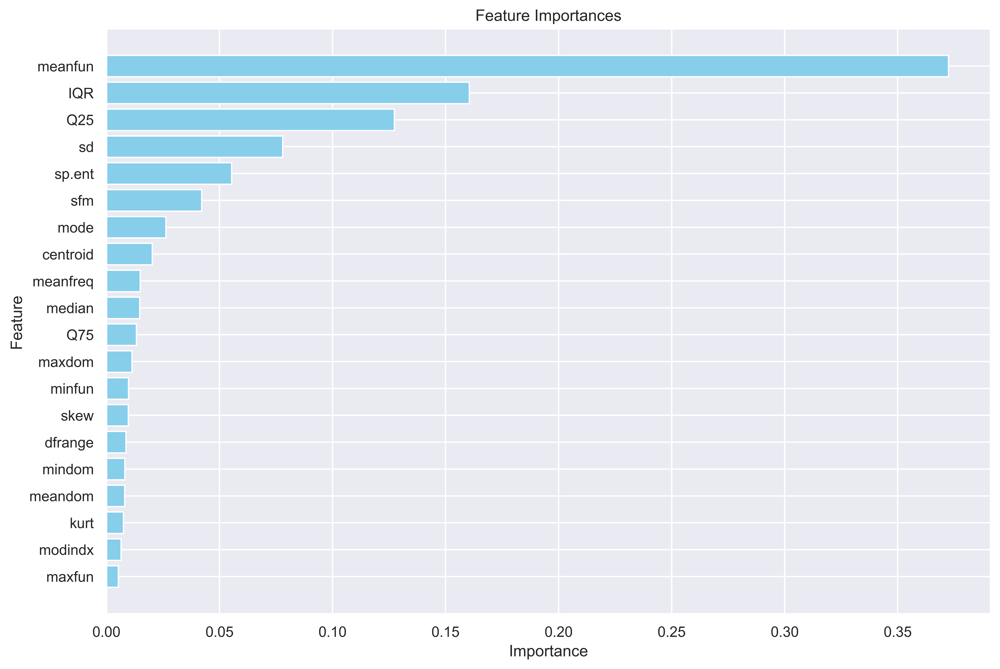

In [ ]:

# Get feature importances
feature_importances = RandomForest.feature_importances_

# Create a DataFrame for better visualization
feature_names = TrainData.drop(columns=["label"]).columns
importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': feature_importances
})

# Sort the DataFrame by importance
importance_df = importance_df.sort_values(by='Importance', ascending=False)

print(importance_df)
# Plot the feature importances
plt.figure(figsize=(12, 8))
plt.barh(importance_df['Feature'], importance_df['Importance'], color='skyblue')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Feature Importances')
plt.gca().invert_yaxis()  # Invert y-axis to have the most important feature on top
plt.show()

The list of top features from the random forest model, along with their importance scores, provides valuable us insights into the factors that the model considers most influential for its predictions. Here’s a breakdown of what these features  represent and why understanding their importance is useful:

meanfun (0.372470): This feature has the highest importance score, indicating it is the most influential in your model's predictions.

IQR (0.160500): Interquartile range, a measure of statistical dispersion.

Q25 (0.127390): The 25th percentile of the data.

sd (0.077944): Standard deviation, a measure of data variability.

sp.ent (0.055358): Spectral entropy, likely related to the frequency domain analysis.

sfm (0.042113): Possibly spectral flatness measure.

mode (0.026271): The mode of the data.

centroid (0.020274): The centroid of the data, often used in frequency analysis.

meanfreq (0.014931): Mean frequency.

The features listed are common in audio signal processing and are typically extracted to characterize various aspects of audio signals.

These features are extracted using various signal processing techniques such as Fourier Transform, statistical analysis, and time-domain analysis and by specialized software packages. They provide a comprehensive characterization of audio signals.

In [ ]:
# Extract the top 5 features
top_5_features = importance_df.head(5)['Feature'].values

# Create a pair plot for the top 5 features
sns.pairplot(data, vars=top_5_features, hue='label', diag_kind='kde')
plt.show()

In [11]:
# Ensure 'label' is categorical
df['label'] = df['label'].astype('category')
plot(df, 'label')

/usr/local/lib/python3.10/dist-packages/dask/dataframe/core.py:3725: UserWarning: Dask currently has limited support for converting pandas extension dtypes to arrays. Converting int64[pyarrow] to object dtype.
  warnings.warn(


ValueError: Metadata inference failed in `mul`.

Original error is below:
------------------------
TypeError("values should be integer numpy array. Use the 'pd.array' function instead")

Traceback:
---------
  File "/usr/local/lib/python3.10/dist-packages/dask/dataframe/utils.py", line 193, in raise_on_meta_error
    yield
  File "/usr/local/lib/python3.10/dist-packages/dask/dataframe/core.py", line 6570, in elemwise
    meta = partial_by_order(*parts, function=op, other=other)
  File "/usr/local/lib/python3.10/dist-packages/dask/utils.py", line 1340, in partial_by_order
    return function(*args2, **kwargs)
  File "/usr/local/lib/python3.10/dist-packages/pandas/core/ops/common.py", line 81, in new_method
  File "/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py", line 202, in __mul__
  File "/usr/local/lib/python3.10/dist-packages/pandas/core/series.py", line 6112, in _arith_method
    try_cast: bool | lib.NoDefault = ...,
  File "/usr/local/lib/python3.10/dist-packages/pandas/core/base.py", line 1348, in _arith_method
  File "/usr/local/lib/python3.10/dist-packages/pandas/core/ops/array_ops.py", line 224, in arithmetic_op
    # error: Argument 1 to "_na_arithmetic_op" has incompatible type
  File "/usr/local/lib/python3.10/dist-packages/pandas/core/ops/common.py", line 81, in new_method
  File "/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py", line 202, in __mul__
  File "/usr/local/lib/python3.10/dist-packages/pandas/core/arrays/masked.py", line 730, in _arith_method
    result : array-like or tuple[array-like]
  File "/usr/local/lib/python3.10/dist-packages/pandas/core/arrays/masked.py", line 817, in _maybe_mask_result
    # TODO(jreback) what if we have a non-na float as a fill value?
  File "/usr/local/lib/python3.10/dist-packages/pandas/core/arrays/numeric.py", line 255, in __init__
    dtype_cls = cls._dtype_cls


### Support Vector Classifier
Next we try the support vector classifier (SVC) with 4 different kernel types.

In [ ]:
import sklearn.svm as svm

KernelTypes = ["rbf", "linear", "poly", "sigmoid"]

for CurKernelType in KernelTypes:
    # build it
    SupportVectorClassifier = svm.SVC(kernel = CurKernelType, gamma = 0.01, C = 100)   # can tune these hyper parameters
    SupportVectorClassifier = SupportVectorClassifier.fit(TrainData.drop(columns = ["label"]), TrainData["label"])

    # test it
    TrainPredicitions = SupportVectorClassifier.predict(TrainData.drop(columns = ["label"]))
    ValidationPredictions = SupportVectorClassifier.predict(ValidationData.drop(columns = ["label"]))
    print(CurKernelType + " Train accuracy = ", metrics.accuracy_score(TrainData["label"], TrainPredicitions))
    print(CurKernelType + " Validation accuracy = ", metrics.accuracy_score(ValidationData["label"], ValidationPredictions))
    print()

rbf Train accuracy =  0.9342105263157895
rbf Validation accuracy =  0.9241706161137441

linear Train accuracy =  0.97
linear Validation accuracy =  0.9747235387045814

poly Train accuracy =  0.9342105263157895
poly Validation accuracy =  0.9289099526066351

sigmoid Train accuracy =  0.36
sigmoid Validation accuracy =  0.353870458135861



The first 3 have an accuracy of 90-something percent. However, sigmoid has a far worse performance of mid-30 percent. Why is that? The [documentation](https://scikit-learn.org/stable/auto_examples/svm/plot_svm_kernels.html#sphx-glr-auto-examples-svm-plot-svm-kernels-py) says it "...may not generalize well to unseen data". This is because it tries fitting with a sigmoid shaped curve. Obviously, this didn't work out too well with our data set. The documentation on sigmoid also concludes "Because of it’s specificity, the sigmoid kernel is less commonly used in practice compared to other kernels".

In [ ]:
!pip install tensorflow > /dev/null 2>&1

Epoch 1/50
25/25 [==============================] - 3s 40ms/step - loss: 0.2676 - accuracy: 0.9862 - val_loss: 0.0718 - val_accuracy: 1.0000
Epoch 2/50
25/25 [==============================] - 0s 15ms/step - loss: 0.0299 - accuracy: 1.0000 - val_loss: 0.0102 - val_accuracy: 1.0000
Epoch 3/50
25/25 [==============================] - 0s 14ms/step - loss: 0.0062 - accuracy: 1.0000 - val_loss: 0.0039 - val_accuracy: 1.0000
Epoch 4/50
25/25 [==============================] - 0s 14ms/step - loss: 0.0030 - accuracy: 1.0000 - val_loss: 0.0023 - val_accuracy: 1.0000
Epoch 5/50
25/25 [==============================] - 0s 16ms/step - loss: 0.0018 - accuracy: 1.0000 - val_loss: 0.0015 - val_accuracy: 1.0000
Epoch 6/50
25/25 [==============================] - 0s 11ms/step - loss: 0.0013 - accuracy: 1.0000 - val_loss: 0.0011 - val_accuracy: 1.0000
Epoch 7/50
25/25 [==============================] - 0s 8ms/step - loss: 9.3199e-04 - accuracy: 1.0000 - val_loss: 8.2310e-04 - val_accuracy: 1.0000
Epoch 

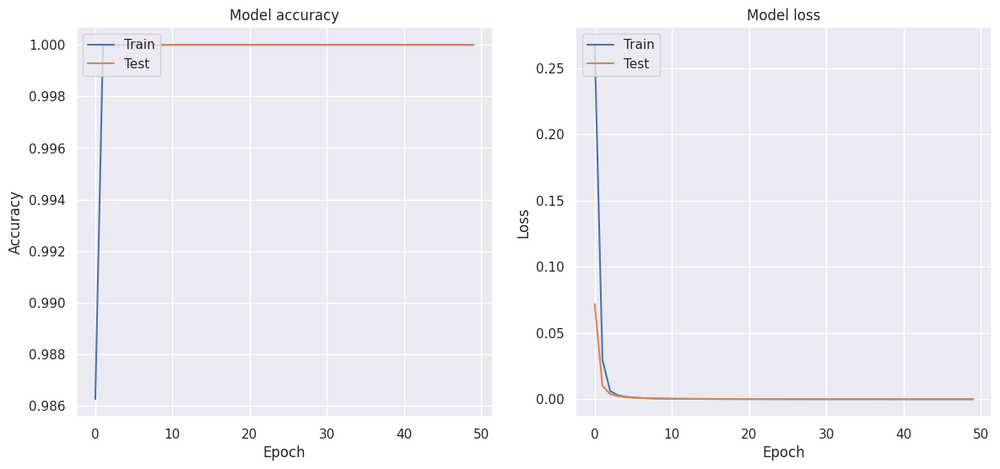

In [ ]:

# Necessary Libraries
import pandas as pd
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder

# Convert 'label' to numeric
df['label'] = df['label'].map({'male': 1, 'female': 0})

# Encode the 'label' column if it is categorical
label_encoder = LabelEncoder()
df['label'] = label_encoder.fit_transform(df['label'])

# Split data into features and target
X = df.drop('label', axis=1)
y = df['label']

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the feature data
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Step 4: Build the Neural Network
model = Sequential()
model.add(Dense(64, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(1, activation='sigmoid'))  # This because we have a binary classification

# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Train the Neural Network
history = model.fit(X_train, y_train, epochs=50, batch_size=32, validation_data=(X_test, y_test))

# Plot Training History
plt.figure(figsize=(14, 6))

plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

plt.show()


7/7 [==============================] - 0s 4ms/step - loss: 1.7974e-05 - accuracy: 1.0000
Training Accuracy: 1.0
Test Accuracy: 1.0


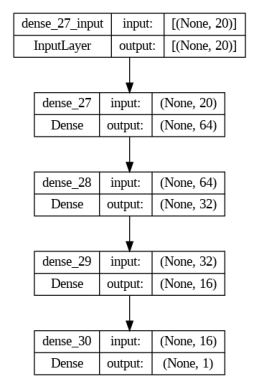

7/7 [==============================] - 0s 4ms/step


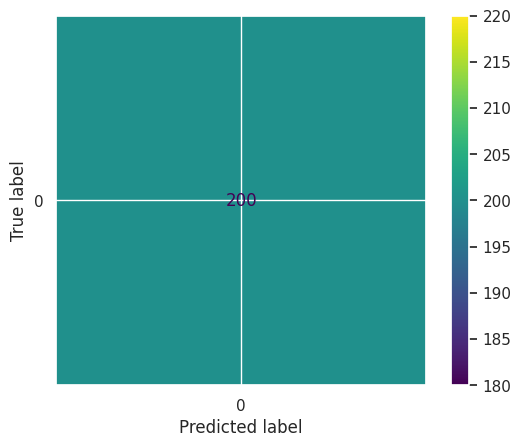

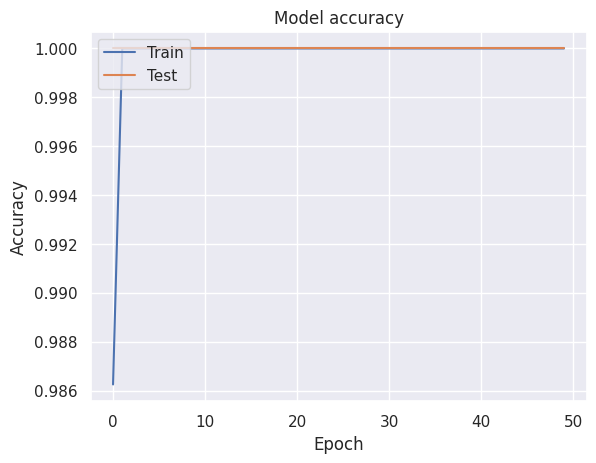

In [ ]:
# Evaluate the model on training and test data
train_loss, train_accuracy = model.evaluate(X_train, y_train)
test_loss, test_accuracy = model.evaluate(X_test, y_test)

print(f'Training Accuracy: {train_accuracy}')
print(f'Test Accuracy: {test_accuracy}')

# Plot the model architecture
tf.keras.utils.plot_model(model, to_file='model.png', show_shapes=True, show_layer_names=True)
img = plt.imread('model.png')
plt.imshow(img)
plt.axis('off')
plt.show()

# Generate predictions
y_pred = (model.predict(X_test) > 0.5).astype("int32")

# Print the confusion matrix
cm = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.show()

# Plot training & validation accuracy values
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

# Evaluation
* performance measures, results, and conclusions...

# Discussion and Conclusions
* address the problem statement and recommendation///